# ClusterMap for STARmap V1_1020

In [1]:
from ClusterMap.clustermap import *
from anndata import AnnData
import tifffile
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import scipy.io
import math
from tqdm import tqdm

### Read spots and dapi image

In [2]:
### set file folder
filepath='./datasets/STARmap_V1_1020/BY1/'

### read dapi: col, row, z
dapi = tifffile.imread(filepath+'BY1_dapi.tiff')

### read spots
spots = pd.read_csv(filepath+'BY1_raw.csv')
spots.columns=['gene_name','spot_location_1','spot_location_2','spot_location_3']

### convert gene_name to gene identity
genes=pd.DataFrame(spots['gene_name'].unique())
a1=list(genes[0])
gene=list(map(lambda x: a1.index(x)+1, spots['gene_name']))
spots['gene']=gene
spots['gene']=spots['gene'].astype('int')

# ### save gene annotation as genelist.csv
genes.to_csv(filepath+'genelist.csv', header=False, index=False)

In [3]:
### set radius parameters
xy_radius=40

Text(0.5, 1.0, 'raw data')

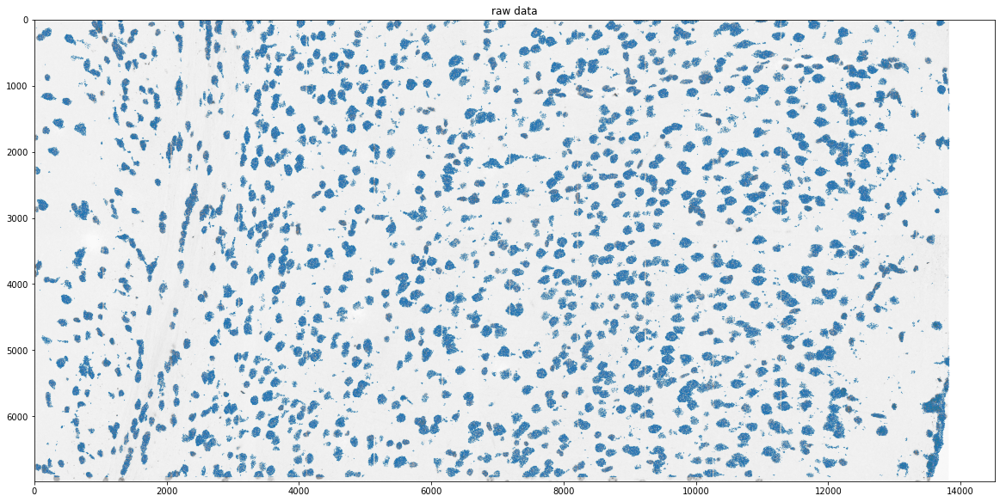

In [4]:
### overview
plt.figure(figsize=(20,20))
length=1000
plt.imshow(dapi,cmap='Greys')
plt.scatter(spots['spot_location_1'],spots['spot_location_2'],s=0.005)
plt.title('raw data')

### instantiate a model for all input data

In [5]:
num_gene=np.max(spots['gene'])

gene_list=np.arange(1,num_gene+1)
num_dims=len(dapi.shape)
model = ClusterMap(spots=spots, dapi=dapi, gene_list=gene_list, num_dims=num_dims,
                   xy_radius=xy_radius,z_radius=0,fast_preprocess=True)

If cell segmentation was performed before, jump to *Perform cell typing (based on Scanpy package)* part.

### split data into small tiles if input is large

In [6]:
### trim
img = dapi
window_size=2000
label_img = get_img(img, spots, window_size=window_size, margin=math.ceil(window_size*0.1))
out = split(img, label_img, spots, window_size=window_size, margin=math.ceil(window_size*0.1))

Split finished: 28 tiles


Text(0.5, 1.0, 'splitted tile: 15')

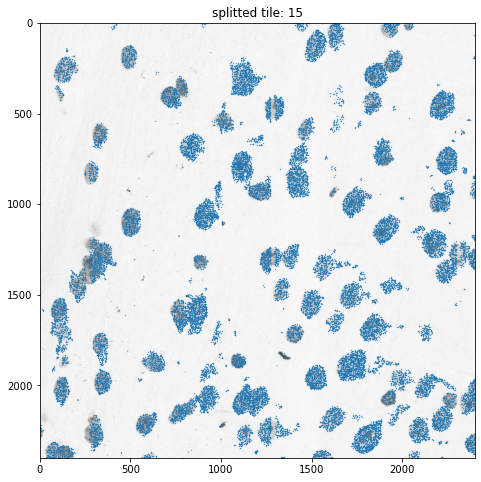

In [7]:
###plot a tile
tile_num=15
plt.figure(figsize=(8,8))
plt.imshow(out.loc[tile_num,'img'],cmap='Greys')

plt.scatter(out.loc[tile_num,'spots']['spot_location_1'],
            out.loc[tile_num,'spots']['spot_location_2'],s=0.1)
plt.title(f'splitted tile: {tile_num}')

### cell segmentation on each tile

tile: 0
After denoising, mRNA spots: 17036
Computing NGC coordinates
After adding DAPI points, all spots:70937
DPC
  Compute spatial distance
  Compute genetic distance


70937it [00:30, 2294.48it/s]


  Compute density rho and the nearest distance


70937it [00:02, 33384.90it/s]
100%|██████████| 33/33 [00:00<00:00, 347.01it/s]


  Find cell number:85.0


100%|██████████| 70937/70937 [00:00<00:00, 733958.45it/s]


Postprocessing


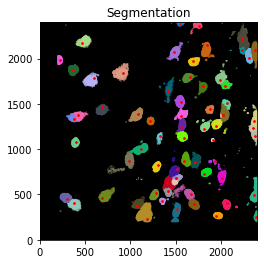

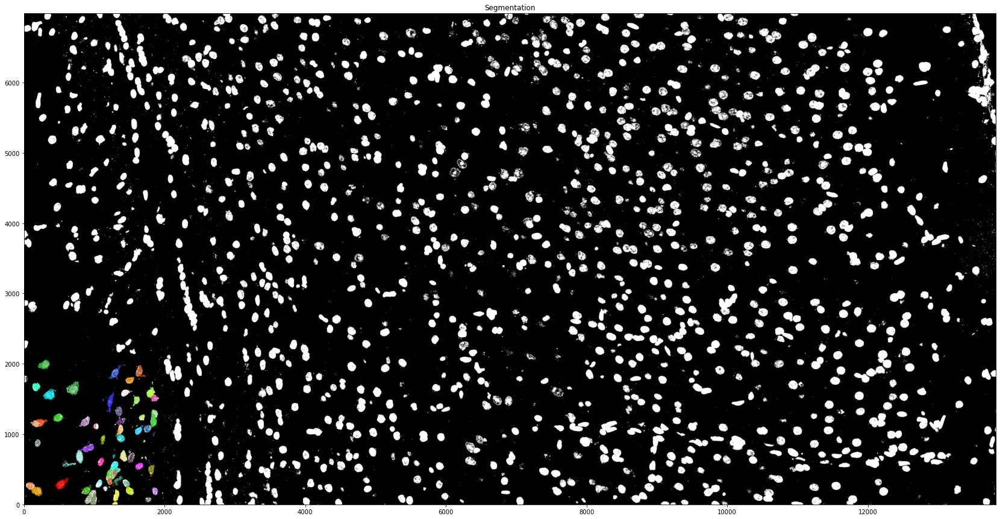

tile: 1
After denoising, mRNA spots: 26267
Computing NGC coordinates
After adding DAPI points, all spots:100151
DPC
  Compute spatial distance
  Compute genetic distance


100151it [00:50, 1986.74it/s]


  Compute density rho and the nearest distance


100151it [00:03, 25849.91it/s]
100%|██████████| 41/41 [00:00<00:00, 633.85it/s]


  Find cell number:80.0


100%|██████████| 100151/100151 [00:00<00:00, 735722.56it/s]


Postprocessing


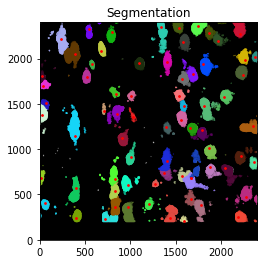

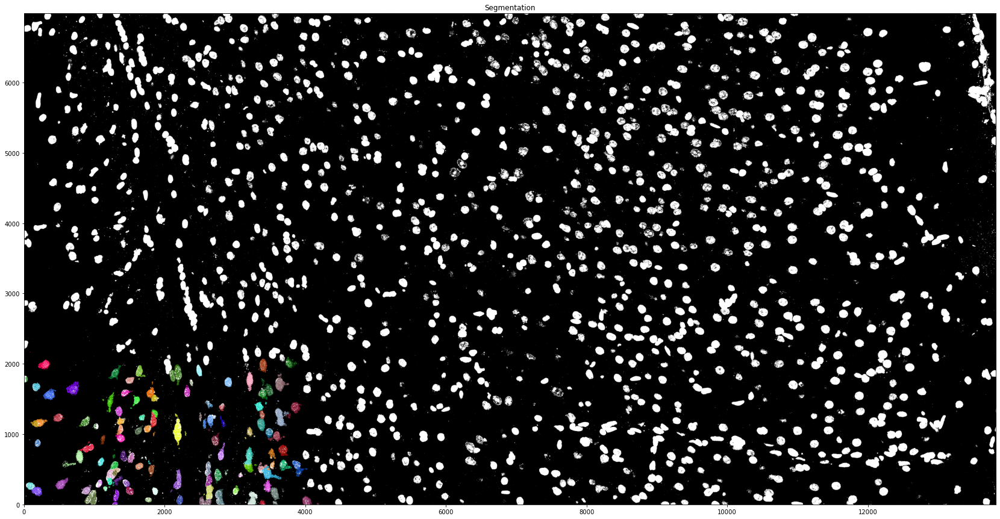

tile: 2
After denoising, mRNA spots: 27423
Computing NGC coordinates
After adding DAPI points, all spots:94514
DPC
  Compute spatial distance
  Compute genetic distance


94514it [00:45, 2069.67it/s]


  Compute density rho and the nearest distance


94514it [00:03, 27702.39it/s]
100%|██████████| 42/42 [00:00<00:00, 360.21it/s]


  Find cell number:100.0


100%|██████████| 94514/94514 [00:00<00:00, 695585.52it/s]


Postprocessing


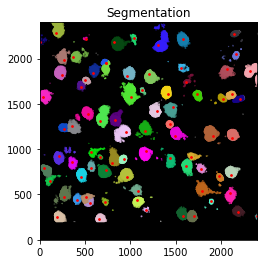

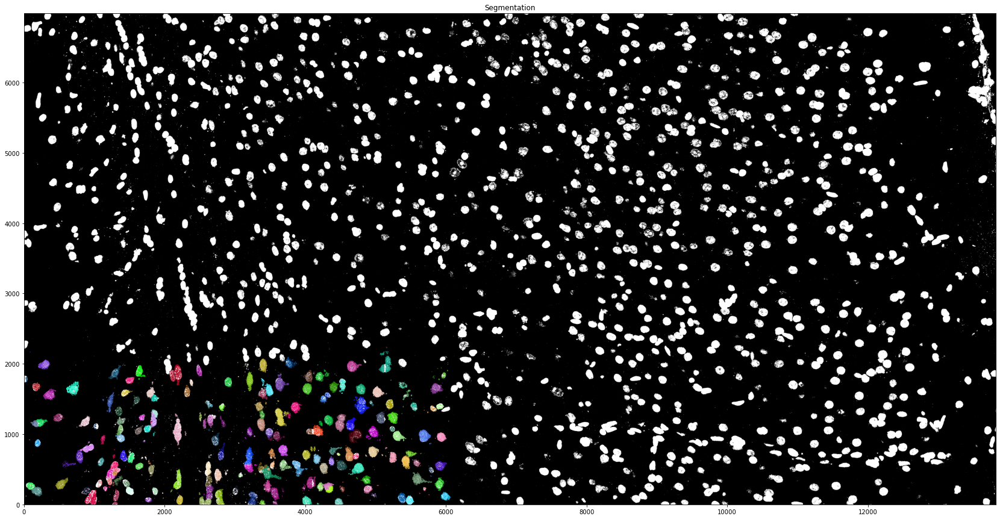

tile: 3
After denoising, mRNA spots: 24599
Computing NGC coordinates
After adding DAPI points, all spots:83302
DPC
  Compute spatial distance
  Compute genetic distance


83302it [00:42, 1953.60it/s]


  Compute density rho and the nearest distance


83302it [00:03, 25033.06it/s]
100%|██████████| 34/34 [00:00<00:00, 79.84it/s] 


  Find cell number:100.0


100%|██████████| 83302/83302 [00:00<00:00, 496951.83it/s]


Postprocessing


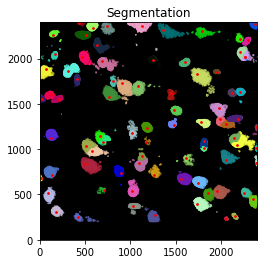

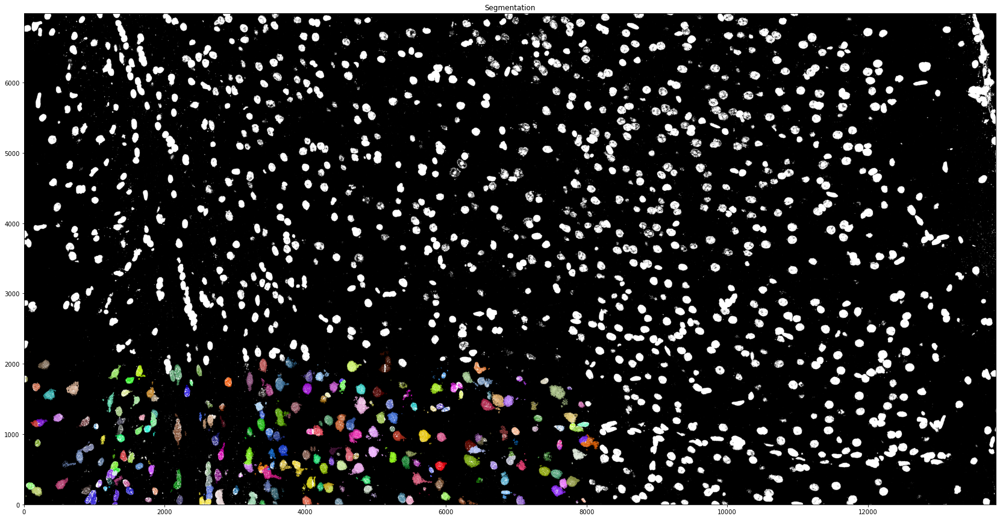

tile: 4
After denoising, mRNA spots: 28571
Computing NGC coordinates
After adding DAPI points, all spots:116614
DPC
  Compute spatial distance
  Compute genetic distance


116614it [00:57, 2030.13it/s]


  Compute density rho and the nearest distance


116614it [00:04, 25517.36it/s]
100%|██████████| 42/42 [00:00<00:00, 370.71it/s]


  Find cell number:105.0


100%|██████████| 116614/116614 [00:00<00:00, 714862.39it/s]


Postprocessing


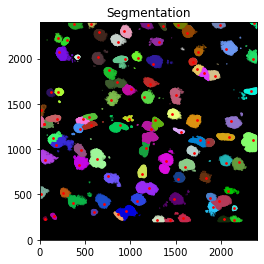

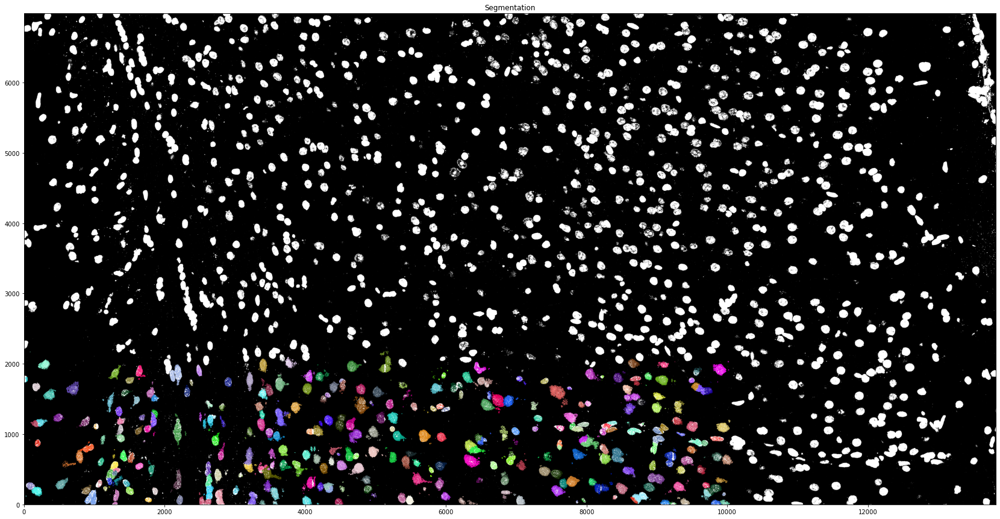

tile: 5
After denoising, mRNA spots: 31131
Computing NGC coordinates
After adding DAPI points, all spots:112775
DPC
  Compute spatial distance
  Compute genetic distance


112775it [00:55, 2032.26it/s]


  Compute density rho and the nearest distance


112775it [00:04, 24857.30it/s]
100%|██████████| 42/42 [00:00<00:00, 566.46it/s]


  Find cell number:95.0


100%|██████████| 112775/112775 [00:00<00:00, 593368.54it/s]


Postprocessing


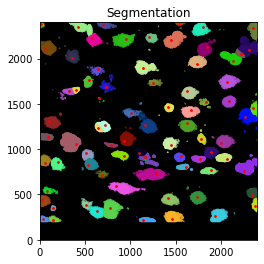

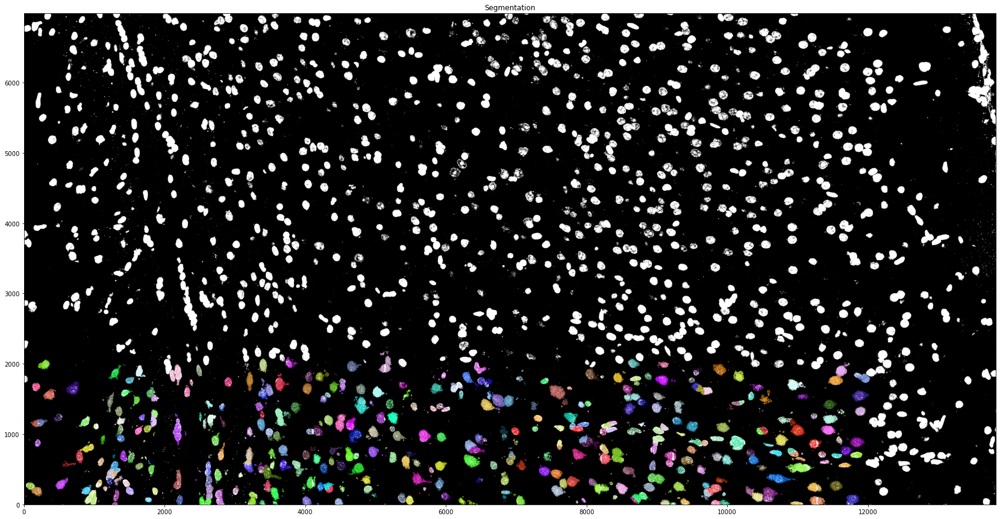

tile: 6
After denoising, mRNA spots: 22845
Computing NGC coordinates
After adding DAPI points, all spots:81769
DPC
  Compute spatial distance
  Compute genetic distance


81769it [00:42, 1933.39it/s]


  Compute density rho and the nearest distance


81769it [00:03, 23087.58it/s]
100%|██████████| 37/37 [00:00<00:00, 248.99it/s]


  Find cell number:65.0


100%|██████████| 81769/81769 [00:00<00:00, 708006.56it/s]


Postprocessing


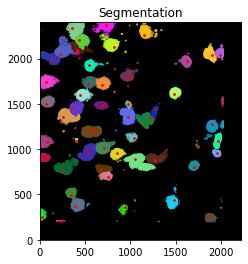

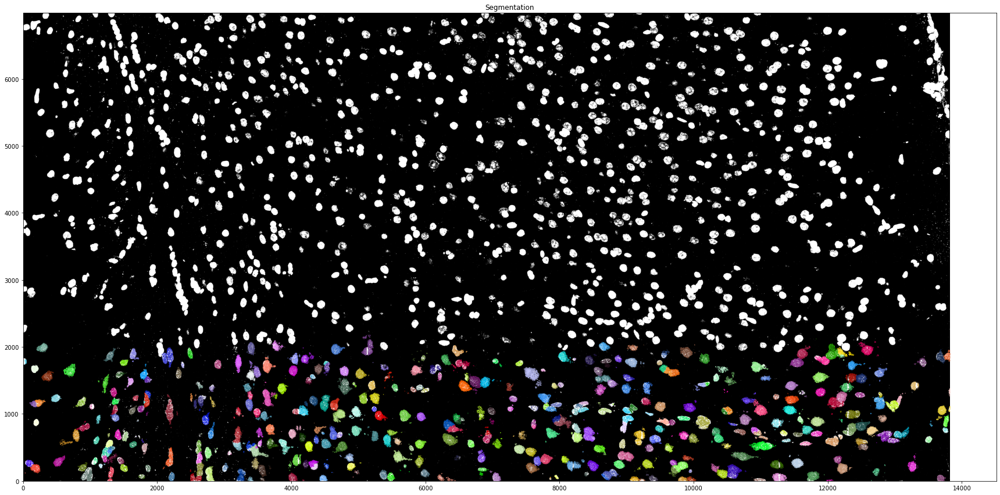

tile: 7
After denoising, mRNA spots: 13849
Computing NGC coordinates
After adding DAPI points, all spots:58476
DPC
  Compute spatial distance
  Compute genetic distance


58476it [00:26, 2240.29it/s]


  Compute density rho and the nearest distance


58476it [00:01, 36529.76it/s]
100%|██████████| 32/32 [00:00<00:00, 215.45it/s]


  Find cell number:60.0


100%|██████████| 58476/58476 [00:00<00:00, 687597.76it/s]


Postprocessing


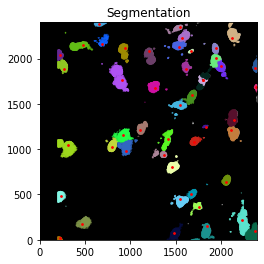

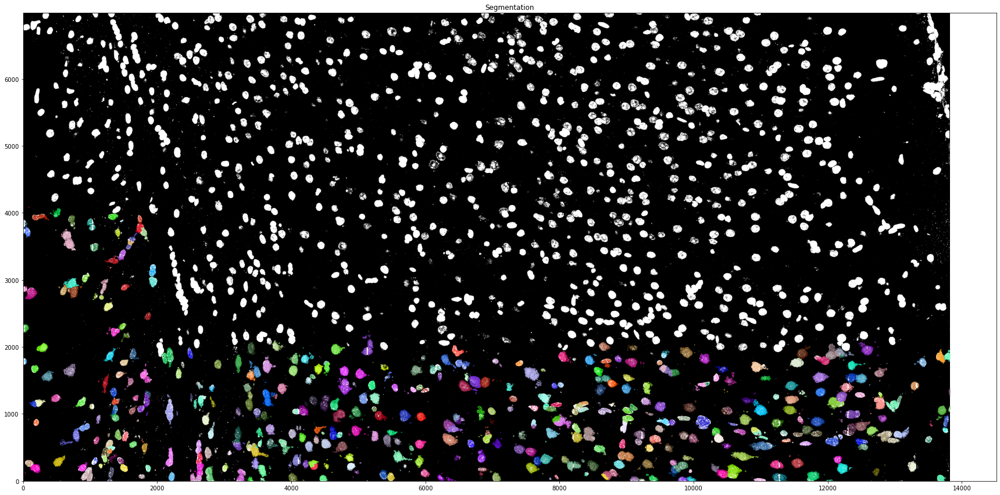

tile: 8
After denoising, mRNA spots: 27254
Computing NGC coordinates
After adding DAPI points, all spots:104990
DPC
  Compute spatial distance
  Compute genetic distance


104990it [00:45, 2310.23it/s]


  Compute density rho and the nearest distance


104990it [00:04, 24796.71it/s]
100%|██████████| 45/45 [00:00<00:00, 242.13it/s]


  Find cell number:95.0


100%|██████████| 104990/104990 [00:00<00:00, 745493.41it/s]


Postprocessing


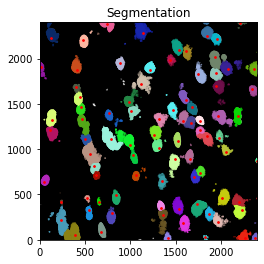

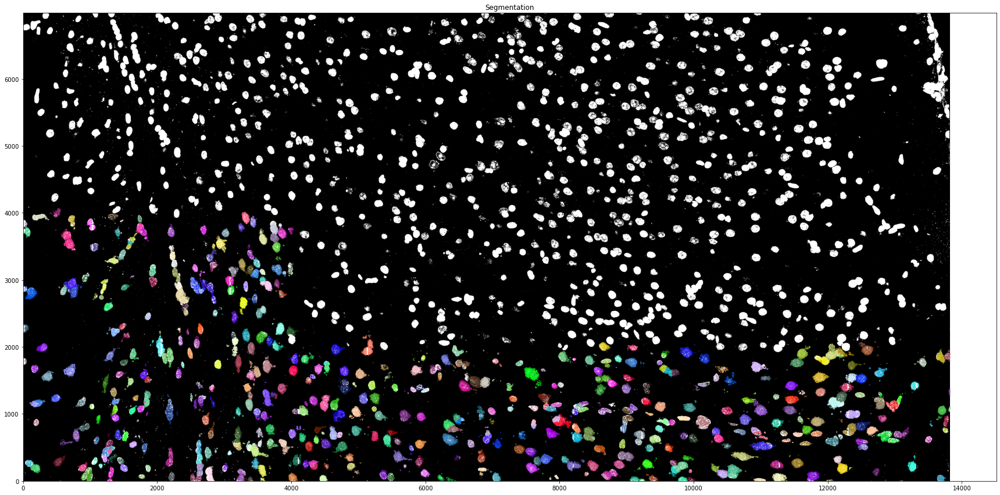

tile: 9
After denoising, mRNA spots: 24978
Computing NGC coordinates
After adding DAPI points, all spots:82305
DPC
  Compute spatial distance
  Compute genetic distance


82305it [00:34, 2355.44it/s]


  Compute density rho and the nearest distance


82305it [00:02, 37085.01it/s]
100%|██████████| 42/42 [00:00<00:00, 214.36it/s]


  Find cell number:75.0


100%|██████████| 82305/82305 [00:00<00:00, 738718.87it/s]


Postprocessing


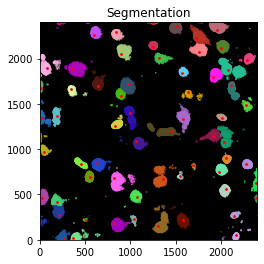

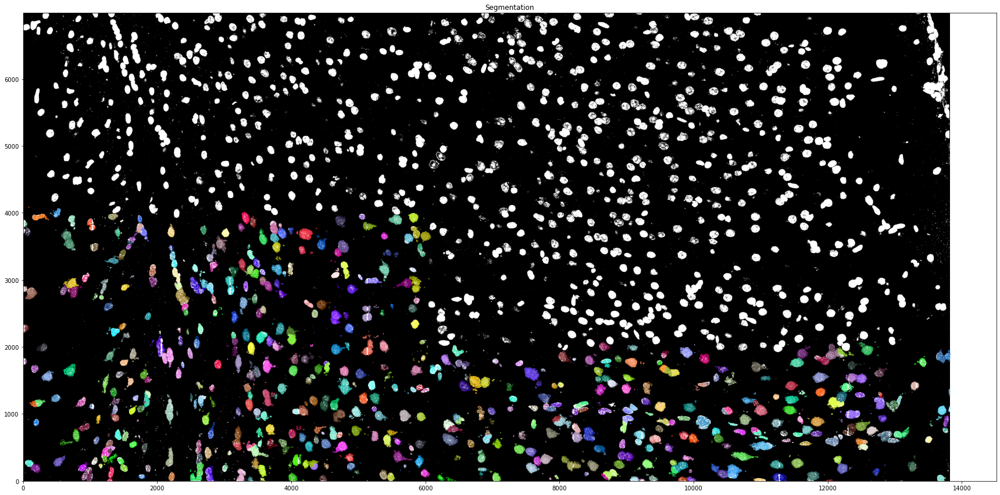

tile: 10
After denoising, mRNA spots: 28989
Computing NGC coordinates
After adding DAPI points, all spots:96907
DPC
  Compute spatial distance
  Compute genetic distance


96907it [00:38, 2502.17it/s]


  Compute density rho and the nearest distance


96907it [00:02, 33688.24it/s]
100%|██████████| 43/43 [00:00<00:00, 228.58it/s]


  Find cell number:95.0


100%|██████████| 96907/96907 [00:00<00:00, 744167.18it/s]


Postprocessing


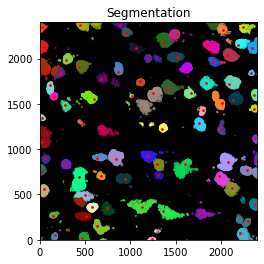

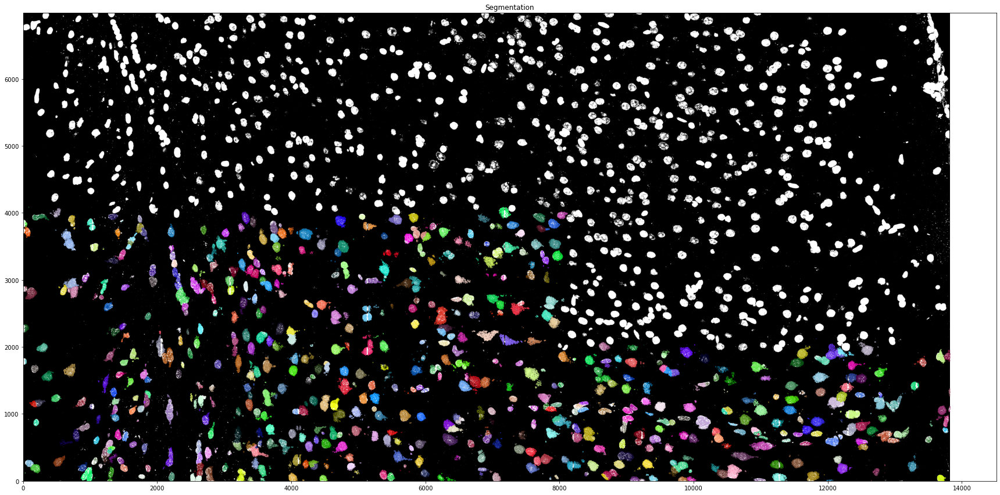

tile: 11
After denoising, mRNA spots: 36677
Computing NGC coordinates
After adding DAPI points, all spots:137250
DPC
  Compute spatial distance
  Compute genetic distance


137250it [01:08, 2015.85it/s]


  Compute density rho and the nearest distance


137250it [00:05, 24215.43it/s]
100%|██████████| 54/54 [00:00<00:00, 283.48it/s]


  Find cell number:145.0


100%|██████████| 137250/137250 [00:00<00:00, 686720.55it/s]


Postprocessing


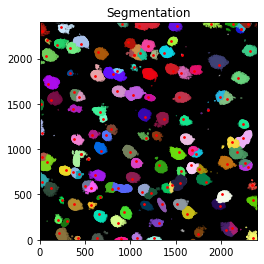

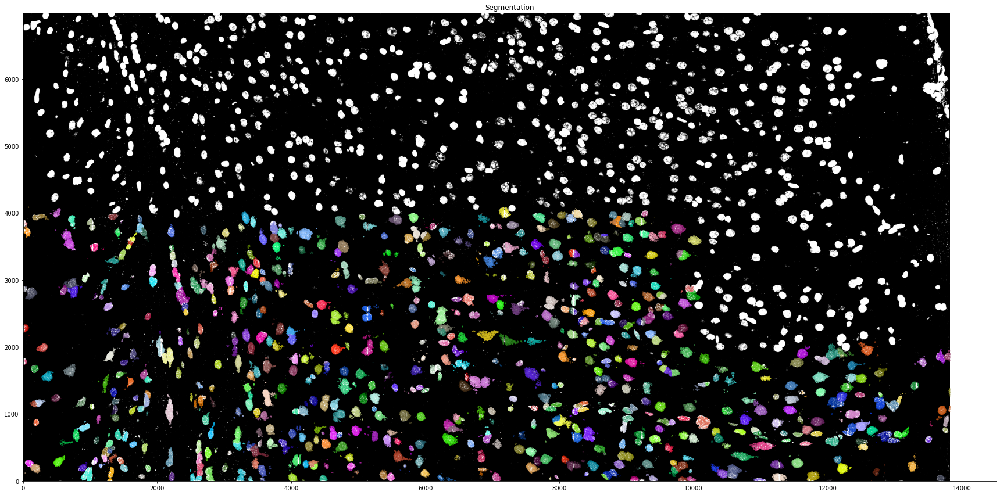

tile: 12
After denoising, mRNA spots: 36253
Computing NGC coordinates
After adding DAPI points, all spots:119675
DPC
  Compute spatial distance
  Compute genetic distance


119675it [00:56, 2131.09it/s]


  Compute density rho and the nearest distance


119675it [00:05, 23334.00it/s]
100%|██████████| 45/45 [00:00<00:00, 342.99it/s]


  Find cell number:85.0


100%|██████████| 119675/119675 [00:00<00:00, 740494.87it/s]


Postprocessing


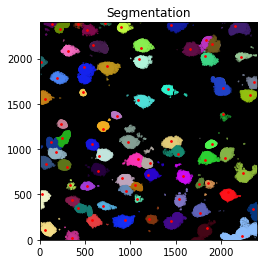

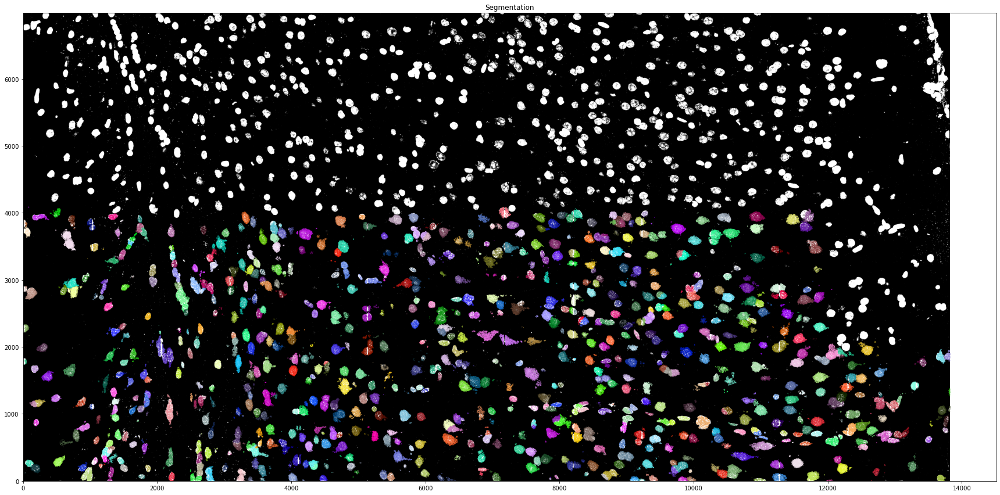

tile: 13
After denoising, mRNA spots: 20869
Computing NGC coordinates
After adding DAPI points, all spots:70161
DPC
  Compute spatial distance
  Compute genetic distance


70161it [00:33, 2068.16it/s]


  Compute density rho and the nearest distance


70161it [00:01, 43254.17it/s]
100%|██████████| 35/35 [00:00<00:00, 202.47it/s]


  Find cell number:65.0


100%|██████████| 70161/70161 [00:00<00:00, 736274.91it/s]


Postprocessing


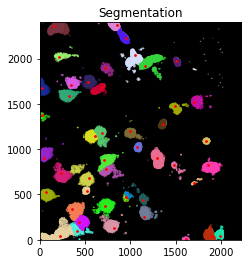

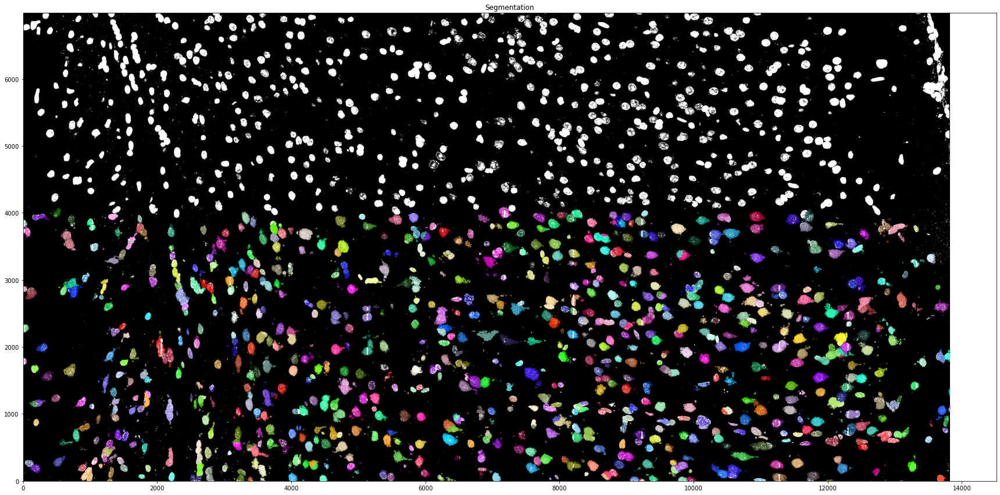

tile: 14
After denoising, mRNA spots: 18312
Computing NGC coordinates
After adding DAPI points, all spots:75671
DPC
  Compute spatial distance
  Compute genetic distance


75671it [00:31, 2370.58it/s]


  Compute density rho and the nearest distance


75671it [00:01, 40493.33it/s]
100%|██████████| 42/42 [00:00<00:00, 427.22it/s]


  Find cell number:90.0


100%|██████████| 75671/75671 [00:00<00:00, 731099.66it/s]


Postprocessing


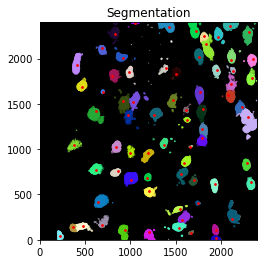

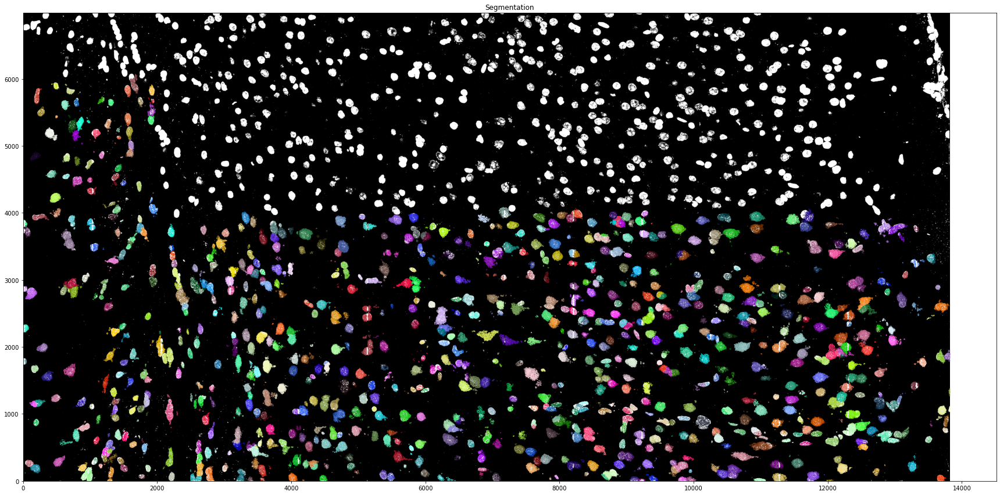

tile: 15
After denoising, mRNA spots: 27670
Computing NGC coordinates
After adding DAPI points, all spots:98846
DPC
  Compute spatial distance
  Compute genetic distance


98846it [00:42, 2342.13it/s]


  Compute density rho and the nearest distance


98846it [00:03, 29538.67it/s]
100%|██████████| 45/45 [00:00<00:00, 306.92it/s]


  Find cell number:95.0


100%|██████████| 98846/98846 [00:00<00:00, 752452.74it/s]


Postprocessing


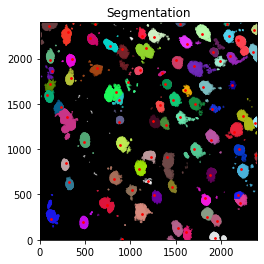

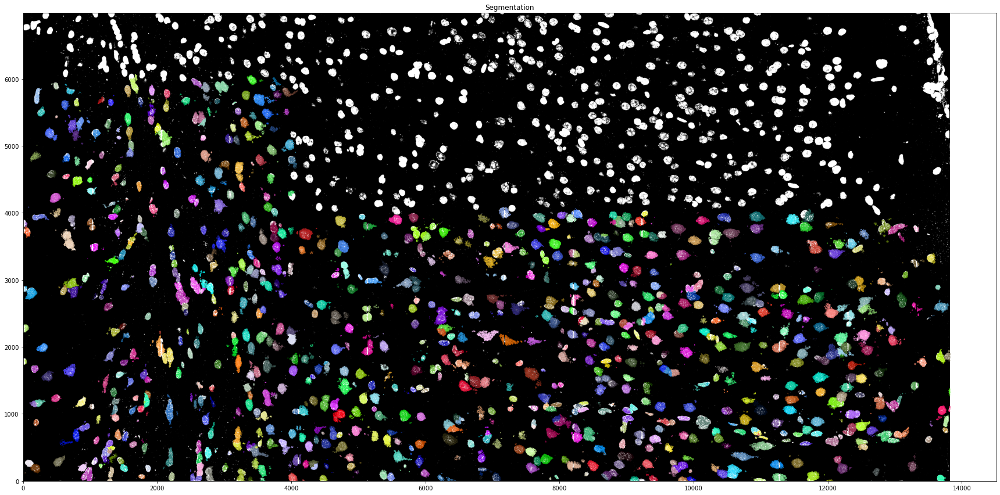

tile: 16
After denoising, mRNA spots: 28244
Computing NGC coordinates
After adding DAPI points, all spots:95663
DPC
  Compute spatial distance
  Compute genetic distance


95663it [00:44, 2171.18it/s]


  Compute density rho and the nearest distance


95663it [00:03, 26434.92it/s]
100%|██████████| 45/45 [00:00<00:00, 288.21it/s]


  Find cell number:100.0


100%|██████████| 95663/95663 [00:00<00:00, 735013.95it/s]


Postprocessing


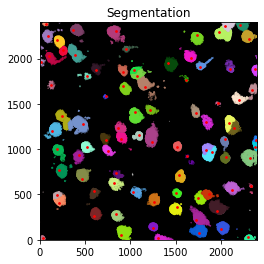

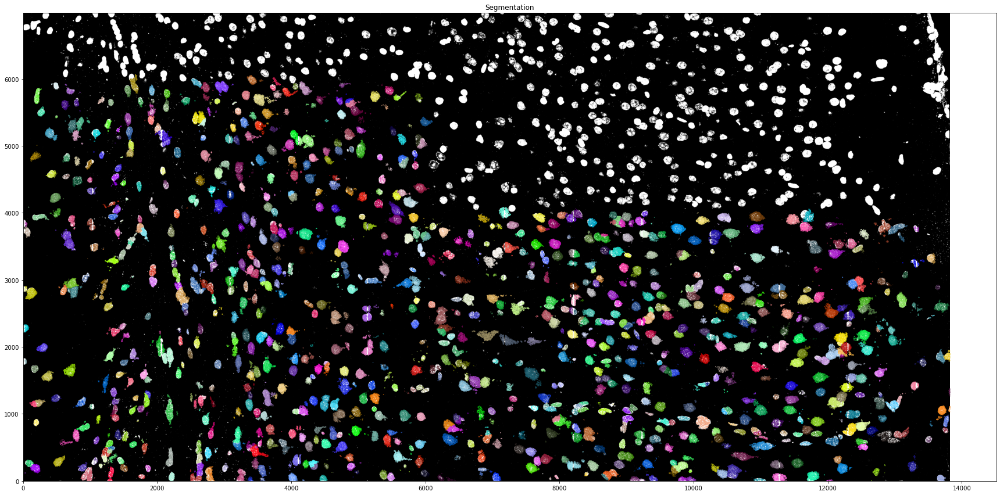

tile: 17
After denoising, mRNA spots: 30609
Computing NGC coordinates
After adding DAPI points, all spots:105360
DPC
  Compute spatial distance
  Compute genetic distance


105360it [00:46, 2267.66it/s]


  Compute density rho and the nearest distance


105360it [00:03, 28041.37it/s]
100%|██████████| 46/46 [00:00<00:00, 332.92it/s]


  Find cell number:105.0


100%|██████████| 105360/105360 [00:00<00:00, 743652.65it/s]


Postprocessing


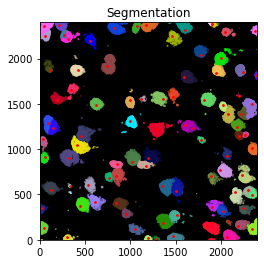

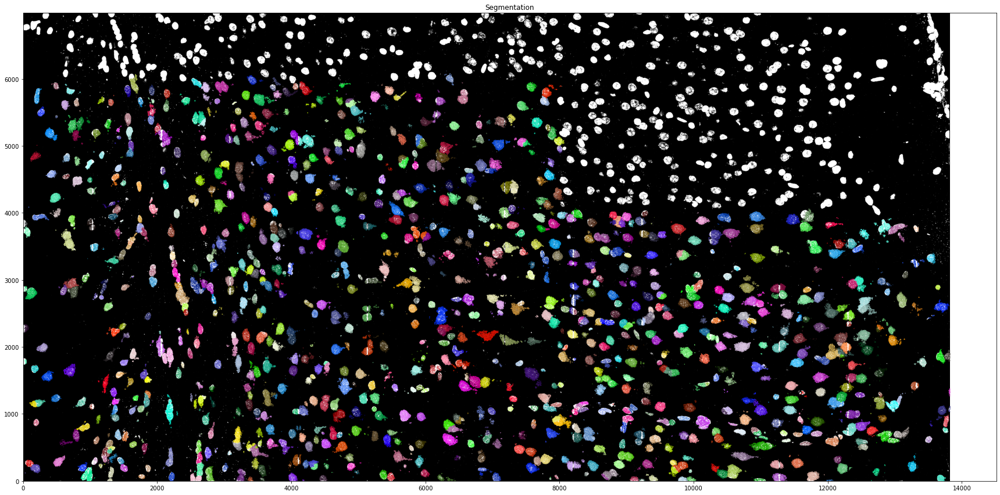

tile: 18
After denoising, mRNA spots: 39051
Computing NGC coordinates
After adding DAPI points, all spots:147370
DPC
  Compute spatial distance
  Compute genetic distance


147370it [01:06, 2211.50it/s]


  Compute density rho and the nearest distance


147370it [00:06, 22100.70it/s]
100%|██████████| 44/44 [00:00<00:00, 349.47it/s]


  Find cell number:125.0


100%|██████████| 147370/147370 [00:00<00:00, 753338.00it/s]


Postprocessing


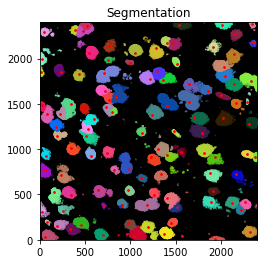

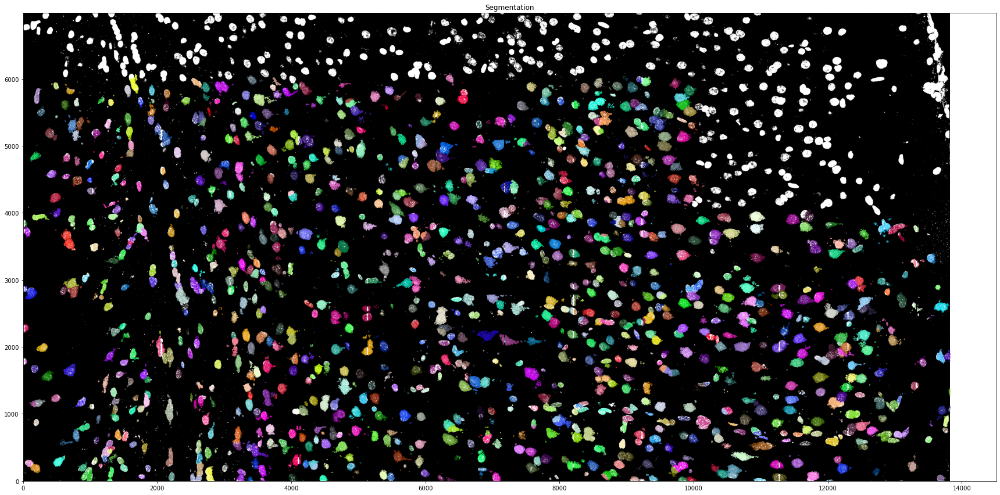

tile: 19
After denoising, mRNA spots: 38697
Computing NGC coordinates
After adding DAPI points, all spots:133272
DPC
  Compute spatial distance
  Compute genetic distance


133272it [01:06, 2013.58it/s]


  Compute density rho and the nearest distance


133272it [00:05, 24663.39it/s]
100%|██████████| 51/51 [00:00<00:00, 347.14it/s]


  Find cell number:95.0


100%|██████████| 133272/133272 [00:00<00:00, 753379.23it/s]


Postprocessing


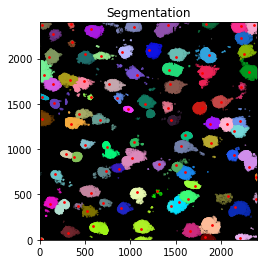

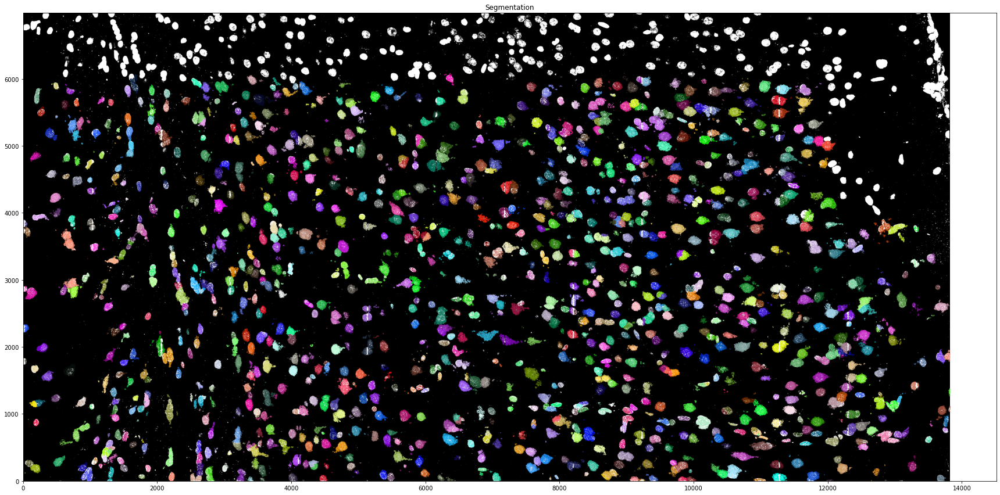

tile: 20
After denoising, mRNA spots: 17070
Computing NGC coordinates
After adding DAPI points, all spots:60489
DPC
  Compute spatial distance
  Compute genetic distance


60489it [00:25, 2346.77it/s]


  Compute density rho and the nearest distance


60489it [00:02, 28898.80it/s]
100%|██████████| 35/35 [00:00<00:00, 168.88it/s]


  Find cell number:50.0


100%|██████████| 60489/60489 [00:00<00:00, 597942.17it/s]


Postprocessing


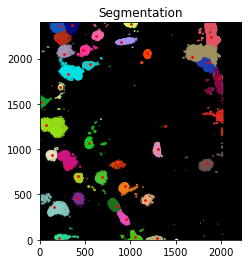

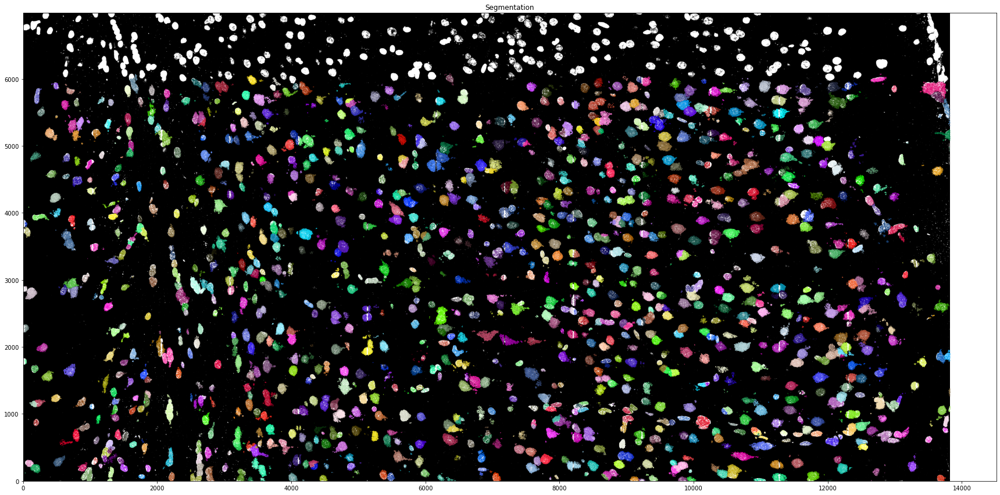

tile: 21
After denoising, mRNA spots: 8845
Computing NGC coordinates
After adding DAPI points, all spots:46317
DPC
  Compute spatial distance
  Compute genetic distance


46317it [00:19, 2365.87it/s]


  Compute density rho and the nearest distance


46317it [00:01, 36065.30it/s]
100%|██████████| 24/24 [00:00<00:00, 270.77it/s]


  Find cell number:65.0


100%|██████████| 46317/46317 [00:00<00:00, 749492.01it/s]


Postprocessing


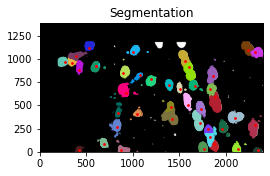

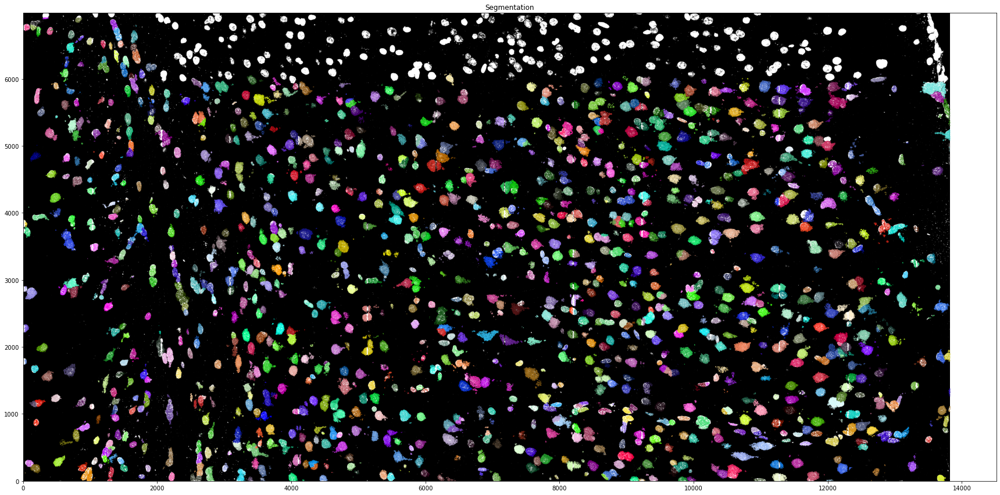

tile: 22
After denoising, mRNA spots: 16770
Computing NGC coordinates
After adding DAPI points, all spots:67502
DPC
  Compute spatial distance
  Compute genetic distance


67502it [00:31, 2158.83it/s]


  Compute density rho and the nearest distance


67502it [00:02, 24237.32it/s]
100%|██████████| 24/24 [00:00<00:00, 550.01it/s]


  Find cell number:65.0


100%|██████████| 67502/67502 [00:00<00:00, 751137.25it/s]


Postprocessing


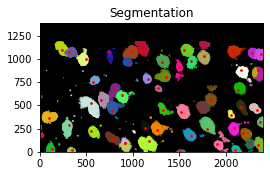

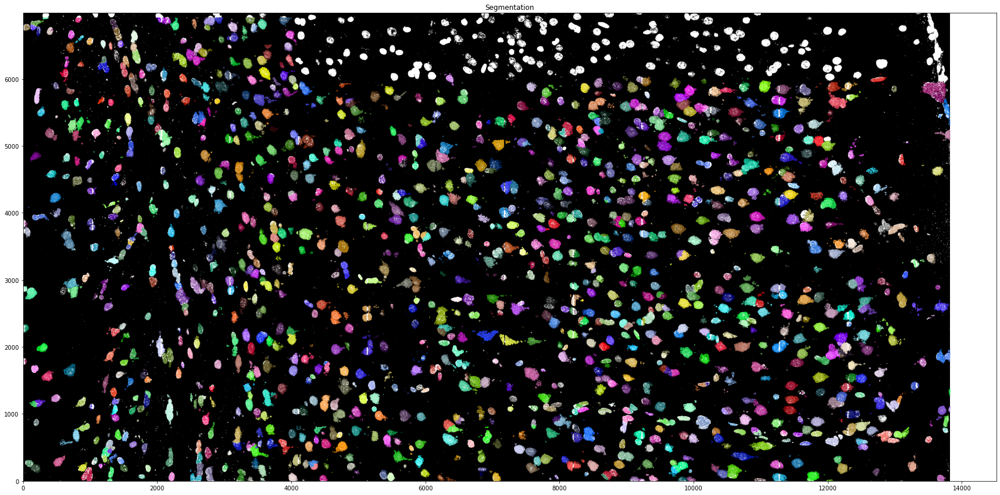

tile: 23
After denoising, mRNA spots: 13185
Computing NGC coordinates
After adding DAPI points, all spots:48488
DPC
  Compute spatial distance
  Compute genetic distance


48488it [00:21, 2272.19it/s]


  Compute density rho and the nearest distance


48488it [00:00, 51405.52it/s]
100%|██████████| 19/19 [00:00<00:00, 685.63it/s]


  Find cell number:70.0


100%|██████████| 48488/48488 [00:00<00:00, 730691.67it/s]


Postprocessing


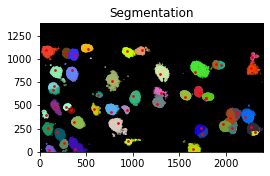

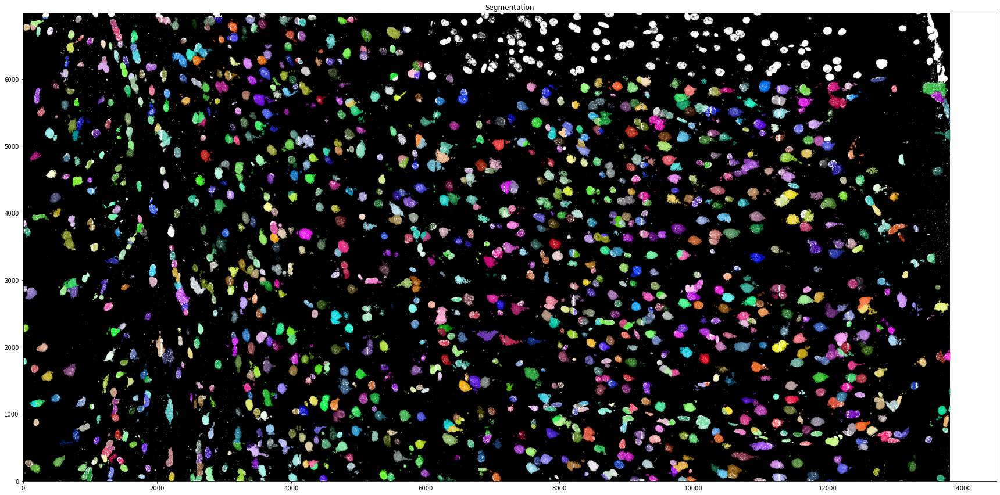

tile: 24
After denoising, mRNA spots: 15799
Computing NGC coordinates
After adding DAPI points, all spots:64529
DPC
  Compute spatial distance
  Compute genetic distance


64529it [00:28, 2231.73it/s]


  Compute density rho and the nearest distance


64529it [00:02, 23133.20it/s]
100%|██████████| 23/23 [00:00<00:00, 325.56it/s]


  Find cell number:95.0


100%|██████████| 64529/64529 [00:00<00:00, 534910.95it/s]


Postprocessing


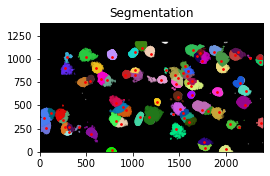

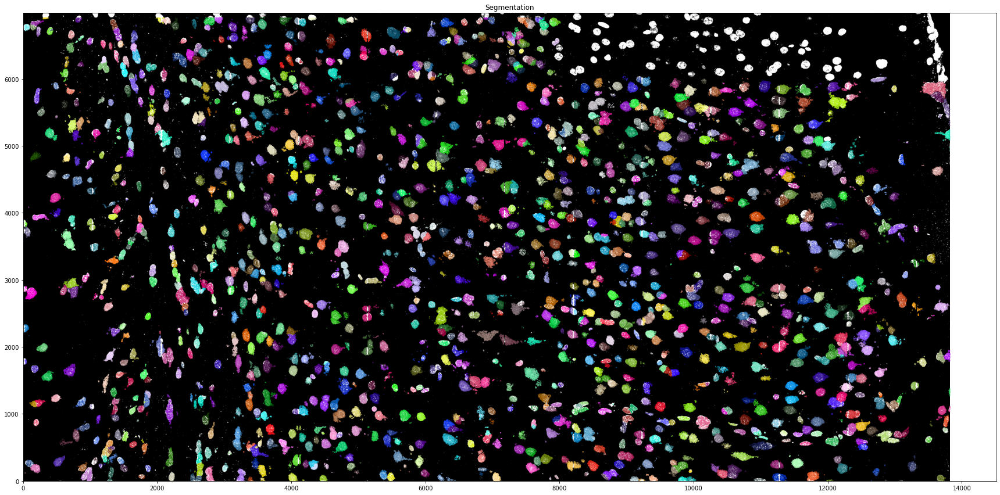

tile: 25
After denoising, mRNA spots: 14405
Computing NGC coordinates
After adding DAPI points, all spots:58301
DPC
  Compute spatial distance
  Compute genetic distance


58301it [00:25, 2254.53it/s]


  Compute density rho and the nearest distance


58301it [00:01, 31639.18it/s]
100%|██████████| 25/25 [00:00<00:00, 602.91it/s]


  Find cell number:60.0


100%|██████████| 58301/58301 [00:00<00:00, 754812.63it/s]


Postprocessing


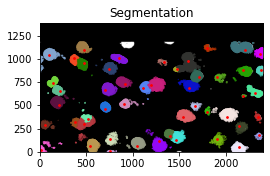

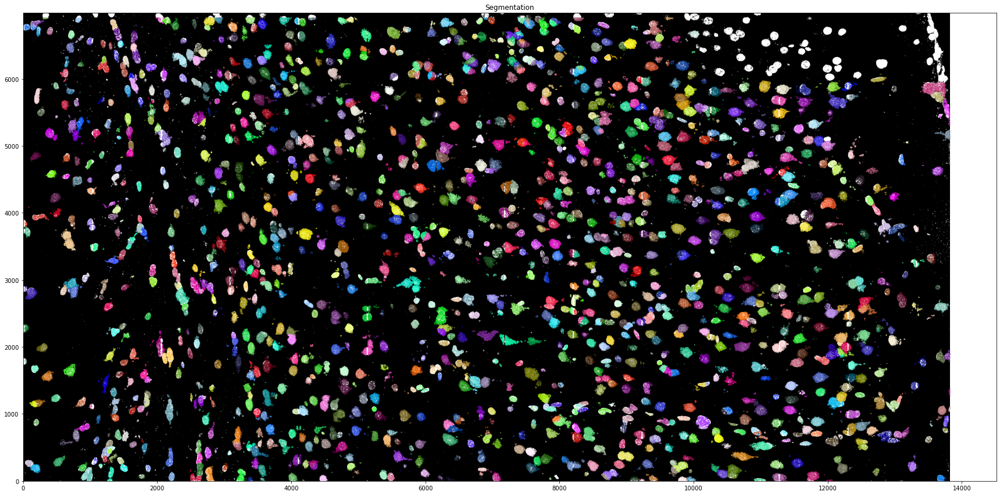

tile: 26
After denoising, mRNA spots: 17539
Computing NGC coordinates
After adding DAPI points, all spots:64326
DPC
  Compute spatial distance
  Compute genetic distance


64326it [00:27, 2306.47it/s]


  Compute density rho and the nearest distance


64326it [00:01, 33379.50it/s]
100%|██████████| 24/24 [00:00<00:00, 574.05it/s]


  Find cell number:65.0


100%|██████████| 64326/64326 [00:00<00:00, 756909.88it/s]


Postprocessing


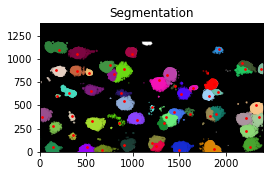

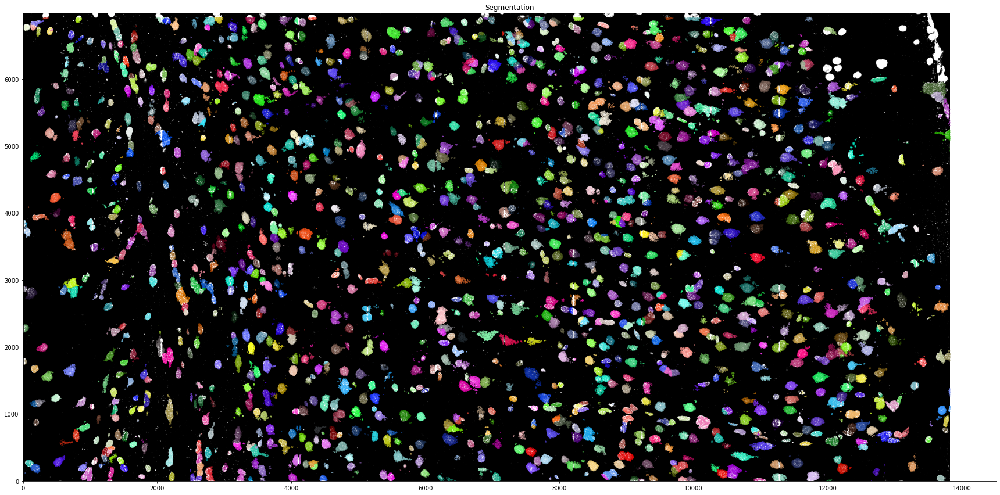

tile: 27
After denoising, mRNA spots: 11404
Computing NGC coordinates
After adding DAPI points, all spots:42245
DPC
  Compute spatial distance
  Compute genetic distance


42245it [00:19, 2172.56it/s]


  Compute density rho and the nearest distance


42245it [00:00, 47515.62it/s]
100%|██████████| 19/19 [00:00<00:00, 342.82it/s]


  Find cell number:60.0


100%|██████████| 42245/42245 [00:00<00:00, 759516.54it/s]


Postprocessing


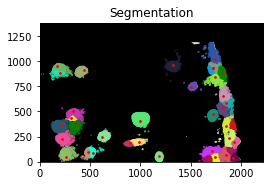

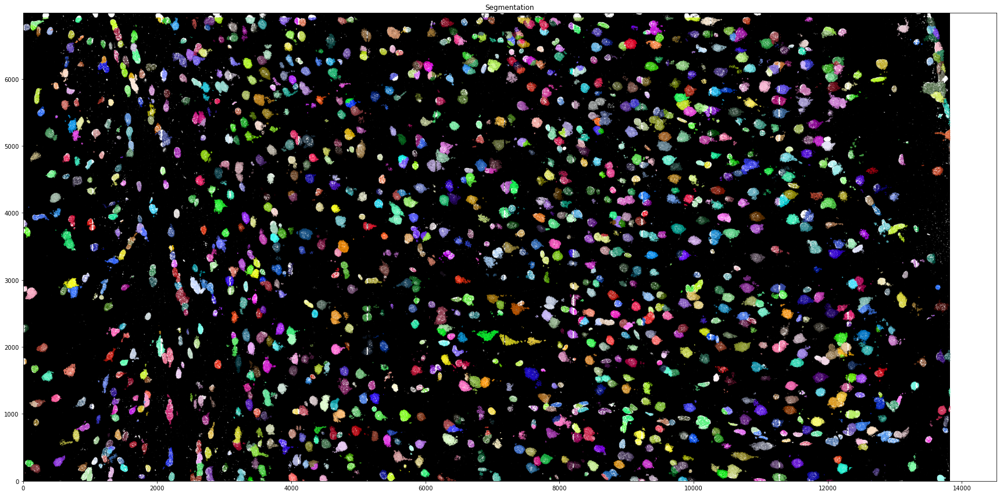

CPU times: user 41min 40s, sys: 2min 30s, total: 44min 10s
Wall time: 46min 17s


In [12]:
%%time

### process each tile
pct_filter=0
model.spots['clustermap']=-1

for tile_num in range(out.shape[0]):
    print(f'tile: {tile_num}')
    spots_tile=out.loc[tile_num,'spots']
    dapi_tile=out.loc[tile_num,'img']

    ### instantiate model
    model_tile = ClusterMap(spots=spots_tile, dapi=dapi_tile, gene_list=gene_list, num_dims=num_dims,
                   xy_radius=xy_radius,z_radius=0,fast_preprocess=False)

    ###preprocessing
    model_tile.preprocess(dapi_grid_interval=3,pct_filter=pct_filter)

    # ### segmentation
    model_tile.min_spot_per_cell=5
    model_tile.segmentation(cell_num_threshold=0.07,dapi_grid_interval=3,add_dapi=True,use_genedis=True)

    # ### plot cell segmentation results in spots (colored by cells)
    model_tile.plot_segmentation(figsize=(4,4),s=0.05,plot_with_dapi=True,plot_dapi=True, show=False)
    plt.scatter(model_tile.cellcenter_unique[:,1],model_tile.cellcenter_unique[:,0],c='r',s=3)

    # ### stitch tiles together
    model.stitch(model_tile,out,tile_num)
    model.plot_segmentation(figsize=(30,15),s=0.05,plot_with_dapi=False,plot_dapi=True, show=False)
    plt.show()

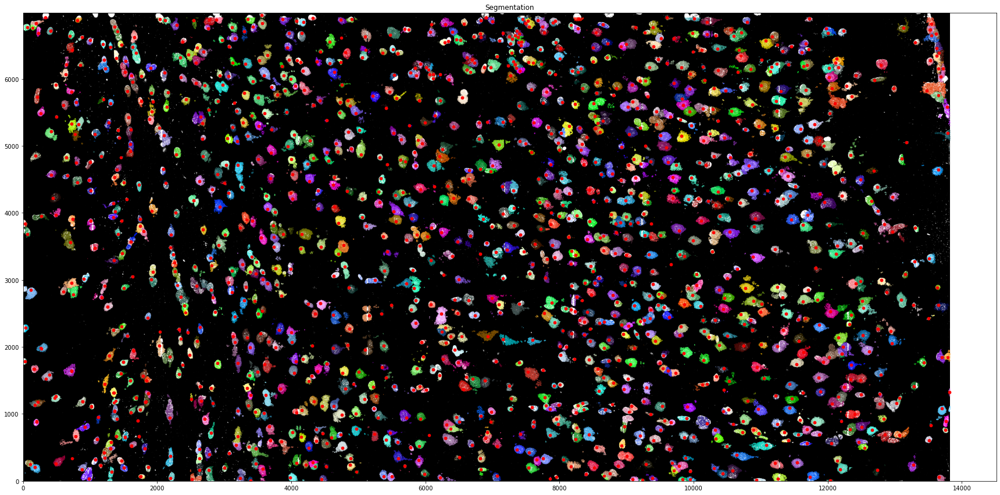

In [15]:
model.plot_segmentation(figsize=(30,15),s=0.05,plot_with_dapi=False,plot_dapi=True, show=False)
plt.scatter(model.cellcenter_unique[:,1],model.cellcenter_unique[:,0],c='r',s=20)
plt.show()

### Save cell segmentation results

In [16]:
path_save = filepath+'spots_all.csv'
model.save_segmentation(path_save)

### Perform cell typing (based on Scanpy package)

In [6]:
###read in saved cell segmentation results
path_save = filepath+'spots_all.csv'
savespots=pd.read_csv(path_save)
model.spots=savespots

In [7]:
cellid='clustermap'
geneid='gene'
num_gene=np.max(spots['gene'])
gene_list=np.arange(1,num_gene+1)
num_dims=len(dapi.shape)

In [8]:
### create adata, saved in model.cell_adata
model.create_cell_adata(cellid,geneid,gene_list,genes,num_dims)

/Users/yichunhe/opt/anaconda3/envs/workEnv/lib/python3.9/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


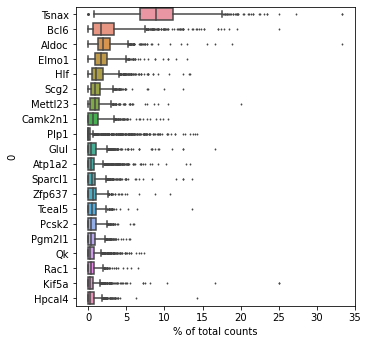

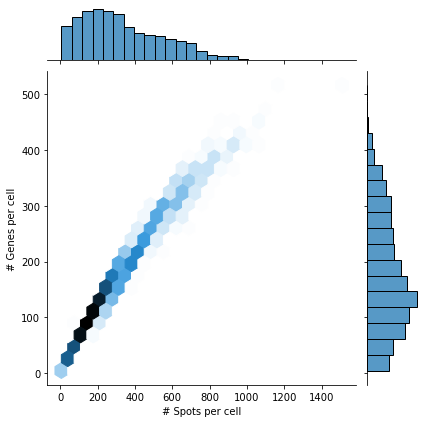

In [9]:
model.cell_preprocess()

Since the number of cells in one sample is relatively small, we apply a main-level to sub-level clustering strategy here to identify reliable cell types.

Main-level cluster

In [10]:
model.cell_typing(cluster_method='leiden',n_clusters=15,resol=1.5)

clustering method: leiden
Leiden clustering
Get 13 clusters


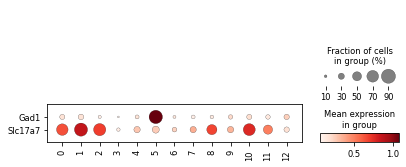

In [11]:
cluster_pl=model.plot_cell_typing(umap=False,
                                  heatmap=False,
                                  print_markers=False,
                                  celltypemap=False)
marker_genes=["Gad1","Slc17a7"]
sc.pl.dotplot(model.cell_adata, marker_genes, groupby='cell_type',swap_axes=True);

From the dotplot, we find that cluster 0,1,2,8,10 are Slc17a7 positive so we annotate them as excitatory neurons. Cluster 5 is Gad1 positive so we annotate it as inhibitory neuron.

In [12]:
merge_list = [[0,1,2,8,10],[3,4,6,7,9,11,12]]

model.merge_multiple_clusters(merge_list)

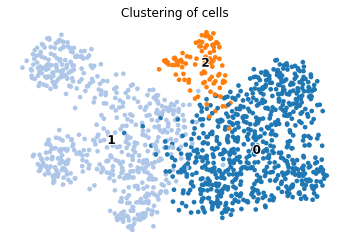

0 ['Pcsk2', 'Pgm2l1', 'Slc17a7', 'Arc', 'Nrgn']
1 ['Plp1', 'Qk', 'Bcl6', 'Apod', 'Ptgds']
2 ['Gad1', 'Scg2', 'Elmo1', 'Tsnax', 'Gad2']


/Users/yichunhe/opt/anaconda3/envs/workEnv/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:661: RuntimeWarning: invalid value encountered in true_divide
  return n_nonzero / X.shape[0]


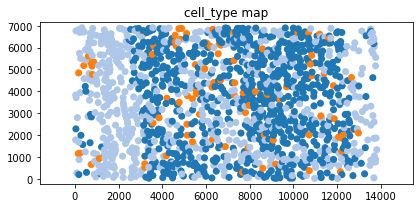

In [13]:
cluster_pl=model.plot_cell_typing(umap=True,
                                  heatmap=False, 
                                  print_markers=True,
                                  celltypemap=True)
# cluster_pl=model.plot_cell_typing()

Sub-level clustering

1. Excitatory neurons

In [14]:
model.exci_adata=model.cell_adata[model.cell_adata.obs['cell_type']==0,:]

In [15]:
model.cell_typing(use_adata=model.exci_adata,
                  cluster_method='leiden',
                  resol=1)

clustering method: leiden
Leiden clustering


Trying to set attribute `.obs` of view, copying.


Get 6 clusters


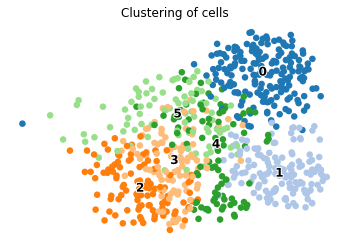

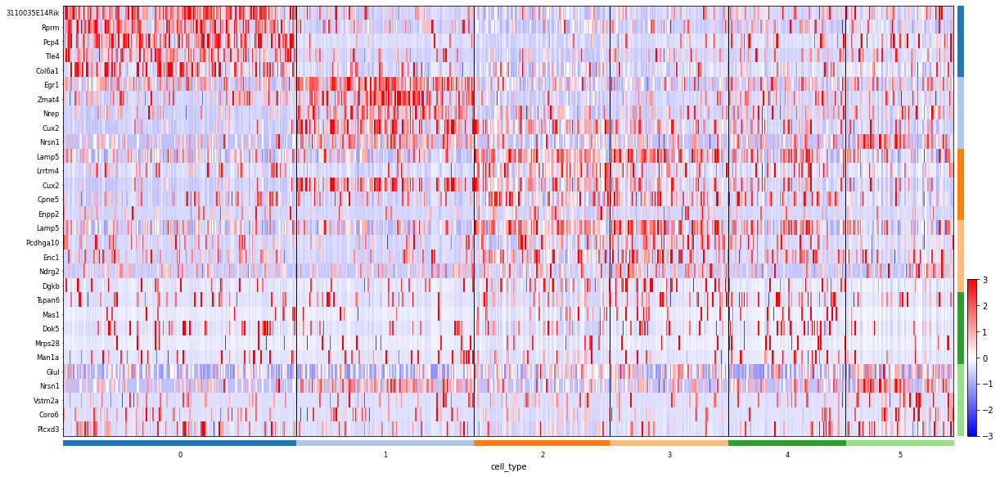

0 ['3110035E14Rik', 'Rprm', 'Pcp4', 'Tle4', 'Col6a1']
1 ['Egr1', 'Zmat4', 'Bcl6', 'Nrep', 'Cux2']
2 ['Lamp5', 'Lrrtm4', 'Cux2', 'Camk2n1', 'Cpne5']
3 ['Camk2n1', 'Lamp5', 'Camk2a', 'Pcdhga10', 'Enc1']
4 ['Mal2', 'Atp9a', 'Fbxw11', 'Slc6a15', 'Ppp3cb']
5 ['Tsnax', 'Glul', 'Nrsn1', 'Cplx1', 'Kif5a']


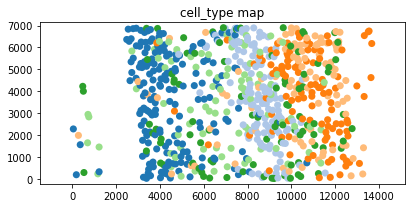

In [16]:
cluster_pl=model.plot_cell_typing(use_adata=model.exci_adata,
                                  umap=True,
                                  heatmap=True, 
                                  print_markers=True,
                                  celltypemap=True)


0: eL6
1: eL4
2: eL2/3-1
3: eL2/3-2
4: Others
5: eL5

2. Inhibitory neurons

In [17]:
model.inhi_adata=model.cell_adata[model.cell_adata.obs['cell_type']==2,:]

In [18]:
model.cell_typing(use_adata=model.inhi_adata,
                  cluster_method='leiden',resol=0.5)

Trying to set attribute `.obs` of view, copying.


clustering method: leiden
Leiden clustering
Get 3 clusters


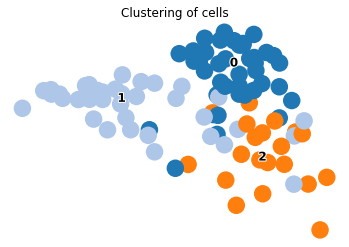

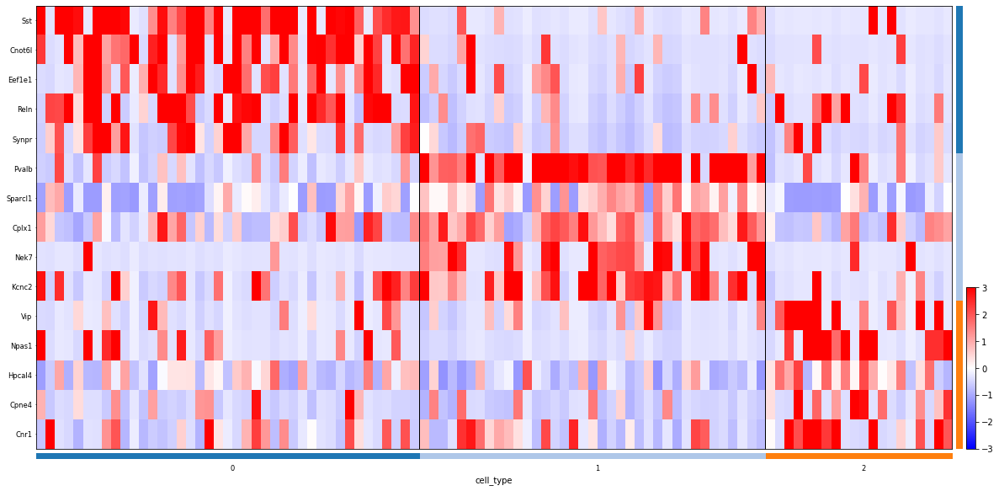

0 ['Sst', 'Cnot6l', 'Eef1e1', 'Reln', 'Synpr']
1 ['Pvalb', 'Sparcl1', 'Cplx1', 'Nek7', 'Kcnc2']
2 ['Vip', 'Npas1', 'Hpcal4', 'Cpne4', 'Cnr1']


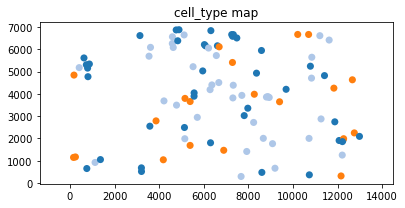

In [19]:
cluster_pl=model.plot_cell_typing(use_adata=model.inhi_adata,
                                  umap=True,
                                  heatmap=True, 
                                  print_markers=True,
                                  celltypemap=True)


0:Sst
1:Pv
2:Vip

3. Non-neuronal cells

In [20]:
model.nonn_adata=model.cell_adata[model.cell_adata.obs['cell_type']==1,:]

In [26]:
model.cell_typing(use_adata=model.nonn_adata,
                  cluster_method='leiden',resol=0.65)

clustering method: leiden
Leiden clustering
Get 5 clusters


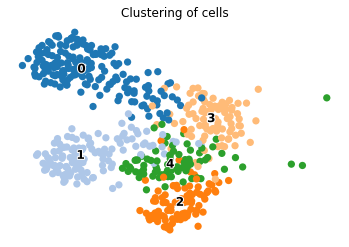

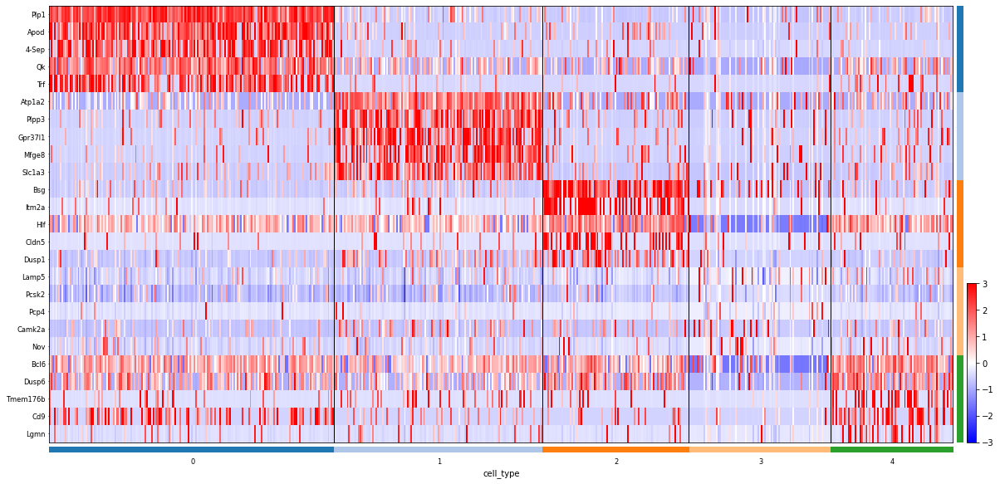

0 ['Plp1', 'Apod', '4-Sep', 'Qk', 'Trf']
1 ['Atp1a2', 'Plpp3', 'Gpr37l1', 'Mfge8', 'Slc1a3']
2 ['Bsg', 'Itm2a', 'Hlf', 'Cldn5', 'Dusp1']
3 ['Lamp5', 'Pcsk2', 'Pcp4', 'Camk2a', 'Nov']
4 ['Bcl6', 'Dusp6', 'Tmem176b', 'Tsnax', 'Hlf']


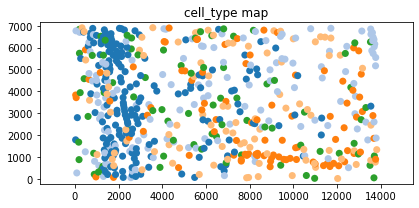

In [27]:
cluster_pl=model.plot_cell_typing(use_adata=model.nonn_adata,
                                  umap=True,
                                  heatmap=True, 
                                  print_markers=True,
                                  celltypemap=True)


In [28]:
###combine sub-clustering results
model.combine_cell_type([model.exci_adata,model.inhi_adata,model.nonn_adata])

In [29]:
model.map_cell_type_to_spots(cellid)

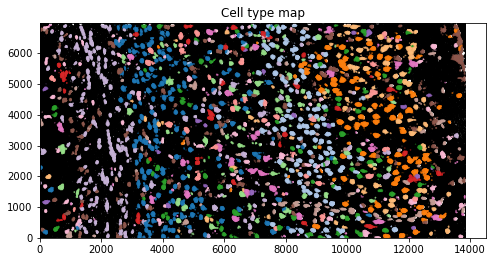

In [30]:
### plot cell segmentation results in spots (colored by cells)
cmap=sns.color_palette('tab20',20)
model.plot_segmentation(figsize=(8,8),method='cell_type',s=0.005,plot_with_dapi=True,plot_dapi=True, show=False,cmap=np.array(cmap))
plt.title('Cell type map')
plt.show()

### Tissue region identification

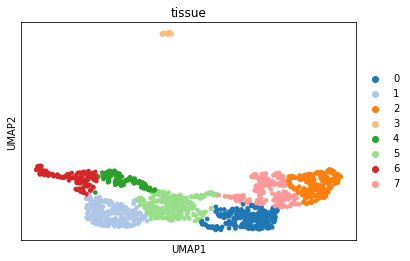

In [103]:
model.compute_ncc(tissue_radius=400,n_neighbors=20)
model.tissue_identify(region=8,cmap=cmap)

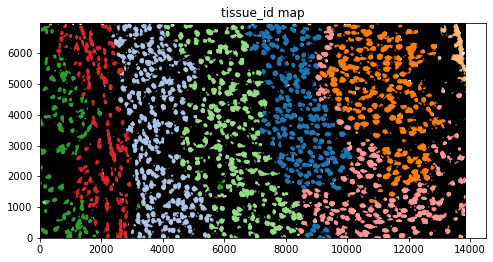

In [104]:
### plot tissue region results in spots (colored by cells)
model.map_cell_type_to_spots(cellid,target_name='tissue_id')
model.plot_segmentation(figsize=(8,8),method='tissue_id',s=0.005,plot_with_dapi=True,plot_dapi=True, show=False,
                       cmap=np.array(cmap))
plt.title('tissue_id map')
plt.show()

Note: Region 3 is separte because of some mixed vascular cells.